In [1]:
import numpy as np

In [2]:
from matplotlib import pyplot as plt

In [3]:
%matplotlib inline

In [4]:
# %load Multiple_Coll_01.py
import numpy as np
from matplotlib import pyplot as plt
def orto(x):
    if np.dot(x,x) == 0:
        return 'No se puede: ese es el vector cero!'
    else:
        if 0 not in x:
            v1 = 1
            v2 = -(x[0]/x[1])
            v3 = 0
            #return np.array([v1,v2,v3])
        else:
            if x[0] == 0:
                if x[1] == 0:
                    v1 = 1
                    v2 = 0
                    v3 = 0
                else:
                    v1 = 0
                    v2 = 0
                    v3 = 1
            elif x[1] == 0:
                v1 = 0
                v2 = 1
                v3 = 0
            else:
                v1 = 0
                v2 = 0
                v3 = 1
        return np.array([v1,v2,v3])
    
#Funcion que regresa dos vectores; numpy arrays de 3D, ortogonales al vector de input x.
#Esto es, devuelven la base al espacio ortogonal definido por el vector x de entrada.
#@jit
def base_ort_nor(x):
    y = orto(x)
    v1 = y/np.linalg.norm(y)
    z = np.cross(x,v1)
    v2 = z/np.linalg.norm(z)
    return v1, v2


#Esta funcion genera un vector con distrubucion uniforme en las direcciones sobre un plano tangente a la esfera de radio R.
#@jit
def vector_des(v1,v2):
    na = 2*np.pi*np.random.rand()
    vn = v1*np.cos(na) + v2*np.sin(na)
    return vn/np.linalg.norm(vn)

R = 1

#Normalizamos al vector de desplazamiento para que intersecte al vector de la nueva posicion de acuerdo con que el
#desplazamiento (s) sobre la esfera, sobre este arco de circulo maximo, sea el determinado por el movimiento browniano particular.
#@jit
def vector_q(x,s):
    q = (R)*np.tan(s/(R))
    return q*x

#Dados todos los datos anteriores, esta funcion actualiza la posicion de la particula.
#Lo que hace es que la mueve sobre el plano tangente a la esfera en la direccion predeterminada de tal suerte que el desplazamiento efectivo
#s sobre una geodesica de la esfera, se el deseado, y posteriormente la proyecta sobre la superficie de la esfera.
#@jit
def nuevo_r(r, vector_q):
    y = r + vector_q
    y = y/np.linalg.norm(y)
    return (R)*y

#Esta funcion ensambla todo lo anterior: como imput necesita una posicion inicial y un arco de desplazamiento
#Como output da un vector de posicion nuevo dada un tipo de desplazamiento.
#@jit
def actualiza(r,s):
    v1, v2 = base_ort_nor(r)
    pre_q = vector_des(v1,v2)
    q = vector_q(pre_q, s)
    return nuevo_r(r, q)


#Esta funcion actualiza la posicion de todos los elementos de una lista; particula brownianas.
#@jit
def act_n(lista,s):
    l = []
    for v in lista:
        l.append(actualiza(v,s))
    return l

#Huella de la trayectoria
#La siguiente funcion hace una particion de la trayectoria sobre s en n pedazos y regresa
#una lista de los vectores de esas posiciones sobre la esfera.
#Usa al operador de rotacion.

#@jit
def b_steps_(ri,rf,n):
    l = [ri]
    r0 = ri
    lamb = (np.dot(ri,rf))/((np.linalg.norm(ri))*(np.linalg.norm(rf)))
    
    if abs(lamb) > 1:
        #print 'Is fucked up: there was a rounding '
        if lamb < 0:
            lamb = -1
        else:
            lamb = 1
    
    
    
    theta = np.arccos(lamb)
    #if theta < 1e17:
        #return l
    if theta == 0:
        return [ri,rf]
    
    else:

        normal = np.cross(ri, rf)/ np.linalg.norm(np.cross(ri,rf))
        for i in range(1,n + 1):
            #vi = rot_theta(r0, theta/n, normal)
            vi = rot_finita(r0, -normal, theta/n)
            l.append(vi)
            r0 = vi
        return l


#Operador de Rotacion
#Depende de los parametros r, el vector o punto que queremos rotar; theta el angulo de rotacion; n el vector que define el eje de rotacion y el signo de rotacion.


#@jit
def rot_theta(r, theta, u):
    x = np.array([np.cos(theta) + (u[0]*u[0])*(1 - np.cos(theta)), u[0]*u[1]*(1 - np.cos(theta)) - u[2]*np.sin(theta), u[0]*u[2]*(1 - np.cos(theta)) + u[1]*np.sin(theta)])
    y = np.array([u[1]*u[0]*(1 - np.cos(theta)) + u[2]*np.sin(theta), np.cos(theta) + u[1]*u[1]*(1 - np.cos(theta)), u[1]*u[2]*(1 - np.cos(theta)) - u[0]*np.sin(theta)])
    z = np.array([u[2]*u[0]*(1 - np.cos(theta)) - u[1]*np.sin(theta), u[2]*u[1]*(1 - np.cos(theta)) + u[0]*np.sin(theta), np.cos(theta) + u[2]*u[2]*(1 - np.cos(theta))])
    R = np.array([x,y,z])
    return np.dot(R, r)



#Transformacion de coordenada de esfericas a cartesianas.

#@jit
def trans_s_c(r,theta, phi):
    x = r*np.sin(theta)*np.cos(phi)
    y = r*np.sin(theta)* np.sin(phi)
    z = r*np.cos(theta)
    return x, y, z


#Transformacion de coordenadas de cartesianas a esfericas.
#@jit
def trans_c_s(x,y,z):
    r = np.sqrt(x**2 + y**2 + z**2)
    #print r
    cociente = z/r
    if abs(cociente) > 1:
        if cociente < 0:
            theta = np.arccos(-1)
        else:
            theta = np.arccos(1)
    else:
        
        theta = np.arccos(z/r)
        
    phi = np.arctan(y/x)
    return r, theta, phi



#@jit
def r_uni(theta, phi):
    x = np.sin(theta)*np.cos(phi)
    y = np.cos(theta)*np.cos(phi)
    z = np.cos(theta)
    return np.array([x,y,z])
#@jit
def theta_uni(theta, phi):
    x = np.cos(theta)*np.cos(phi)
    y = np.cos(theta)*np.sin(phi)
    z = -np.sin(theta)
    return np.array([x,y,z])
#@jit
def phi_uni(theta, phi):
    x = -np.sin(phi)
    y = np.cos(phi)
    z = 0
    return np.array([x,y,z])

#@jit
def nombre(s):
    diferencia = 4 - len(str(s))
    ceros = '' 
    for i in range(diferencia):
        ceros = ceros + '0'
    variable = ceros + str(s)
    return variable

#Varianza para una distribucion bigaussiana; difusion en 2D
#@jit
def var(D, delta_t):
    return 4*D*delta_t


#Arco de circulo maximo con distribucion normal alrededor de cero y una varianza dada por
#@jit
def ese(D,delta_t):
    return abs(np.random.normal(loc = 0., scale = np.sqrt(var(D,delta_t)),size = None))

#Funcion de rotacion finita
#@jit
def rot_finita(r_ini, N, Phi):
    n = N/np.linalg.norm(N)
    r_fin = np.cos(Phi)*r_ini + (np.dot(n,r_ini))*(1 - np.cos(Phi))*n + (np.sin(Phi))*(np.cross(r_ini,n))
    return r_fin


#Funcion que regresa una lista de n numpy arrays que son l
def Trayectoria(ri,rf,n):
    l = [ri]
    r0 = ri
    theta = np.arccos((np.dot(ri,rf))/((np.linalg.norm(ri))*(np.linalg.norm(rf))))
    N = np.cross(ri, rf)
    
    for i in range(1,n + 1):
        vi = rot_finita(r0, N, theta/n)
        l.append(vi)
        r0 = vi
    return l

#Collision_check es una función que, dada una trayectoria: una lista de vectores que
#pasan por puntos sucesivos de la trayectoria, verifica si alguna de estas posiciones
#interesecto a alguno de los obstáculos. En caso de que así sea, actualiza conforme una
#colision elastica. En caso de no intersectar a ningun obstaculo regresa una lista
#con dos vectores: posicion inicial y posicion final en ese orden.
#@jit
def penetrate_obs(lista_vect, lista_obs, size):
    metiches = []
    for obs in lista_obs:
        theta_omega = size
        r_omega = obs
        frontera = .2
        #metiches = []
        for v in lista_vect:
            tamanho = np.cos(theta_omega - frontera)
            if np.dot(v,r_omega) > tamanho:
                print 'Penetro el mother fucker obstacle'
                metiches.append(v)
                
            else:
                continue
    #print 'no choco el mother fucker'
    #valor = False
    return metiches


#Esta funcion cuando es llamada grafia la posicion de las partoculas brownianas.
#sobre la superficie de una esfera sobre la que se esta difundiendo.
#@jit
def plot_particles(lista, vpolar, vazim, numero):
    from mpl_toolkits.mplot3d import axes3d
    from mpl_toolkits.mplot3d import Axes3D
    from matplotlib import cm

    #import matplotlib.pyplot as plt
    #import numpy as np
    from itertools import product, combinations
    fig = plt.figure(figsize=(20,10))
    ax = fig.gca(projection='3d')
    ax.set_aspect("equal")
    ax._axis3don = False

    



    #draw sphere
    R = 1
    u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
    x=R*np.cos(u)*np.sin(v)
    y=R*np.sin(u)*np.sin(v)
    z=R*np.cos(v)
    #ax.plot_surface(x, y, z, color="r", alpha = 0.15)

    ax.plot_surface(x, y, z, cmap=cm.YlGnBu_r,rstride=1, cstride=1, alpha = 0.10, linewidth = 0.15)
    ax.view_init(vpolar, vazim)
    
    
    #draw an arrow or a set of arrow
    ax.quiver(0,0,1.5,0,0,1, length=0.5, arrow_length_ratio = .5)
    #draw patch
    #u, v = np.mgrid[0:2*np.pi:50j, 0:(np.pi/7):50j]
    #x=R*np.cos(u)*np.sin(v)
    #y=R*np.sin(u)*np.sin(v)
    #z=R*np.cos(v)
    #ax.plot_surface(x, y, z, color="r", alpha = 0.25)    
    
    #draw points
    for p in lista:
        ax.scatter([p[0]],[p[1]],[p[2]],color="b",s=50, alpha = 0.6)
    
    #fig.savefig('Obs_Dist_Images{}.png'.format(nombre(numero)))
    #ax.view_init(80, 30)
    plt.show()
    #plt.close()

    
    
#@jit
def polo_n(n, R):
    l = []
    for i in range(n):
        l.append(np.array([0,0,R]))
    return l

#@jit
def particion_esfera(ccero, Nphi):
    Ntheta = int(4*np.pi/(ccero*Nphi))
    print 'Ntheta', Ntheta, 'Nphi', Nphi, 'Ntheta*Nphi', Ntheta*Nphi
    sigmaPhi = 2*np.pi/Nphi
    deltaphi = 2*np.pi/Nphi
    thetas = []
    phis = [0]
    cociente = ccero/sigmaPhi
    for i in range(Ntheta + 1):
        theta = np.arccos(1 - (i)*cociente)
        thetas.append(theta)
    for j in range(Nphi):
        phis.append(phis[j] + deltaphi)
    return thetas, phis

#@jit
def secuencia_part(tamini, Nfi, numero):
    l1, l2 = particion_esfera(4*np.pi/tamini, Nfi)
    particion = []
    for i in range(len(l2)):
        for j in range(len(l1)):
            x, y, z = trans_s_c(1, l1[j], l2[i])
            particion.append(np.array([x, y, z]))
            
    return plot_particles(particion, 45, 45, numero)

#Funcion que regresa las coordenadas del centro de dos arreglos para 
#las coordenadas theta y phi
#@jit
def coordenadas_centro(l1,l2):
    thetas_centro = []
    phis_centro = []
    for i in range(len(l1) - 1):
        theta_media = l1[i] + (l1[i + 1] - l1[i])/2.
        thetas_centro.append(theta_media)
    for j in range(len(l2) - 1):
        phi_media = l2[j] + (l2[j + 1] - l2[j])/2.
        phis_centro.append(phi_media)
    return thetas_centro, phis_centro

#@jit(nopython=True)
def secuencia_obs(N, Nfi, numero):
    l1_prima, l2_prima = particion_esfera(4*np.pi/N, Nfi)
    l1, l2 = coordenadas_centro(l1_prima, l2_prima)
    particion = []
    for i in range(len(l2)):
        for j in range(len(l1)):
            x, y, z = trans_s_c(1, l1[j], l2[i])
            particion.append(np.array([x, y, z]))
            
    print len(particion)
    
    #return plot_particles(particion, 0, 0, numero)
    return particion


def plot_particle_traj_obs(lista_obstaculos, trayectoria,  vpolar, vazim, numero):
    from mpl_toolkits.mplot3d import axes3d
    from mpl_toolkits.mplot3d import Axes3D
    from matplotlib import cm

    #import matplotlib.pyplot as plt
    #import numpy as np
    from itertools import product, combinations
    fig = plt.figure(figsize=(20,10))
    ax = fig.gca(projection='3d')
    ax.set_aspect("equal")
    ax._axis3don = False
    

    



    #draw sphere
    R = 1
    u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
    x=R*np.cos(u)*np.sin(v)
    y=R*np.sin(u)*np.sin(v)
    z=R*np.cos(v)
    #ax.plot_surface(x, y, z, color="r", alpha = 0.15)

    ax.plot_surface(x, y, z, cmap=cm.YlGnBu_r,rstride=1, cstride=1, alpha = 0.10, linewidth = 0.15)
    ax.view_init(vpolar, vazim)
    #draw patch
    #u, v = np.mgrid[0:2*np.pi:50j, 0:(np.pi/7):50j]
    #x=R*np.cos(u)*np.sin(v)
    #y=R*np.sin(u)*np.sin(v)
    #z=R*np.cos(v)
    #ax.plot_surface(x, y, z, color="r", alpha = 0.25)
    
    
    
    #draw obstacles
    
    for p in lista_obstaculos:
        ax.scatter([p[0]],[p[1]],[p[2]], color="b", s=10, alpha = 0.2)
    
    #draw trajectory
    for p in trayectoria:
        ax.scatter([p[0]],[p[1]],[p[2]], color="k",s=20, alpha = 0.7)
    
    #Plot the x positive direction
    
    ax.quiver(1.5,0,0,1,0,0, length=0.5, arrow_length_ratio = .5)
    ax.quiver(0,1.5,0,0,1,0, length=0.5, arrow_length_ratio = .5)
    ax.quiver(0,0,1.5,0,0,1, length=0.5, arrow_length_ratio = .5)
    
    #fig.savefig('BS_24_Obs_test_01{}.png'.format(nombre(numero + 1)))
    #ax.view_init(80, 30)
    #plt.close()
    plt.show()

def obs_uniforme(N, R, size):
    
    list_obs = []
    omega = np.cos(size)
    while len(list_obs) < N:
        x, y, z = np.random.uniform(-1,1), np.random.uniform(-1,1), np.random.uniform(-1,1)
        v = np.array([x, y, z])
        norma = np.linalg.norm(v)
        if norma <= R:
            n = v/norma
            if not np.dot(n, np.array([0.,0.,1.]))/R > omega:
                list_obs.append(R*n)
    
    return list_obs    


def puntos_obs_j(r_omega, theta_omega, n):
    r , theta, phi = trans_c_s(r_omega[0],r_omega[1],r_omega[2])
    rp = rot_finita(r_omega, phi_uni(theta, phi), theta_omega)
    puntos_obs_j = [rp]
    for i in range(1,n):
        x = rot_finita(rp, r_omega, 2*np.pi/n)
        puntos_obs_j.append(x)
        rp = x
    return puntos_obs_j



def puntos_obs(lista_obstaculos, size):
    mis_obs = []
    for i in range(len(lista_obstaculos)):
        a = lista_obstaculos[i]
        b = size
        mis_obs = mis_obs + puntos_obs_j(a,b,100)
    return mis_obs
#Collision_check es una función que, dada una trayectoria: una lista de vectores que
#pasan por puntos sucesivos de la trayectoria, verifica si alguna de estas posiciones
#interesecto a alguno de los obstáculos. En caso de que así sea, actualiza conforme una
#colision elastica. En caso de no intersectar a ningun obstaculo regresa una lista
#con dos vectores: posicion inicial y posicion final en ese orden.

def penetrate_obs(lista_vect, lista_obs, size):
    metiches = []
    for obs in lista_obs:
        r_omega, theta_omega = obs, size
        #frontera = .2
        #metiches = []
        for v in lista_vect:
            tamanho = np.cos(theta_omega)
            if np.dot(v,r_omega) >= tamanho:
                #print 'Penetro el mother fucker obstacle'
                metiches.append(v)
                
            else:
                continue
    #print 'no choco el mother fucker'
    #valor = False
    return metiches
    

def check_collision(lista_vect, lista_obs, size):
    for obs in lista_obs:
        r_omega, theta_omega = obs, size 
        for v in lista_vect:
            tamanho = np.cos(theta_omega)
            if np.dot(v,r_omega) > tamanho:
                return  True
            else:
                continue
    return False
    


In [5]:
def tangent_space(x1,x2,xo):
    np_prima = np.cross(np.cross(xo, x1), x1)
    nor_p = np_prima/np.linalg.norm(np_prima)
    up_prima = np.cross(np.cross(x1, x2), x1)
    up = up_prima/np.linalg.norm(up_prima)
    tp_prima = np.cross(x1, nor_p)
    tp = tp_prima/np.linalg.norm(tp_prima)
    y = (np.dot(up,tp))*tp - (np.dot(up, nor_p))*nor_p
    v_rot_prima = np.cross(x1, y)
    v_rot = v_rot_prima/np.linalg.norm(v_rot_prima)
    return v_rot

In [6]:
def collision_check(Lv, Lo, size):
    if len(Lv) == 1:
        return Lv[0], Lv[0], 0
    
    elif len(Lv) == 2:
        sproduct = np.dot(Lv[0], Lv[1])
        if abs(sproduct) > 1:
            if sproduct < 0:
                sproduct = -1.
            else:
                sproduct = 1.
                
        alpha = np.arccos(sproduct)
        for obs in Lo:
            r_o = obs
            if np.dot(Lv[1],r_o) > np.cos(size):
                v_rot = tangent_space(Lv[0], Lv[1], r_o)
                x_final = rot_finita(Lv[1], -v_rot, alpha)
                return Lv[1], x_final, 0
    else:
        for k in range(1,len(Lv)):
            for obs in Lo:
                r_o = obs
                if np.dot(Lv[k],r_o) > np.cos(size):
                    v_rot = tangent_space(Lv[0], Lv[k], r_o)
                    
                    if k == len(Lv) - 1:
                        sproduct = np.dot(Lv[k-1], Lv[k])
                        if abs(sproduct) > 1:
                            if sproduct < 0:
                                sproduct = -1.
                        else:
                            sproduct = 1.
                        
                        
                    
                    else:
                        sproduct = np.dot(Lv[k], Lv[-1])
                        if abs(sproduct) > 1:
                            if sproduct < 0:
                                sproduct = -1.
                            else:
                                sproduct = 1.
                    alpha = np.arccos(sproduct)
                    
                    x_final = rot_finita(Lv[k], -v_rot, alpha)
                    return Lv[k], x_final, k
        return Lv[0], Lv[-1], 0

### Posiciones iniciales

In [7]:
def uniform_inside_omega(N, R, size):
    
    list_obs = []
    omega = np.cos(size)
    while len(list_obs) < N:
        x, y, z = np.random.uniform(-1,1), np.random.uniform(-1,1), np.random.uniform(-1,1)
        v = np.array([x, y, z])
        norma = np.linalg.norm(v)
        if norma <= R:
            n = v/norma
            if not np.dot(n, np.array([0.,0.,1.]))/R < omega:
                list_obs.append(R*n)
    
    return list_obs   

In [49]:
D = 1e-2
dt = (2.3**2/4.)*1e-5
theta1 = 0.4
theta2 = 0.1

In [50]:
pos_ini = uniform_inside_omega(100,1, theta1)

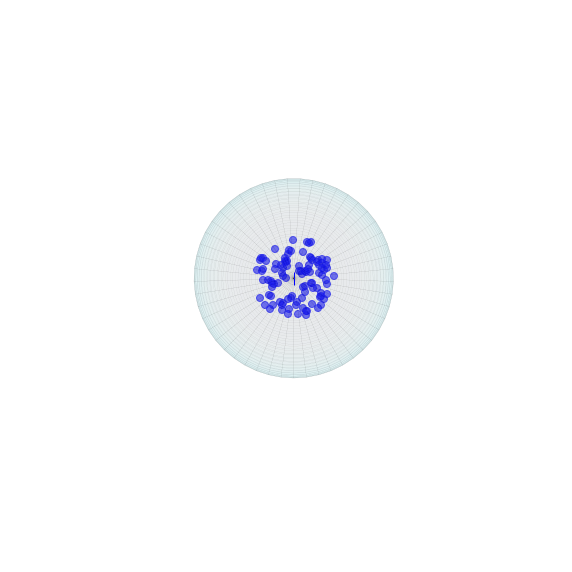

In [51]:
plot_particles(pos_ini,90,0,1)

2.3025850929940459

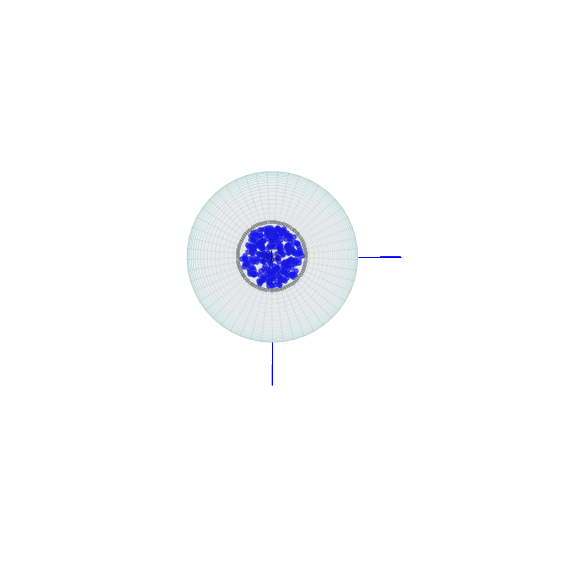

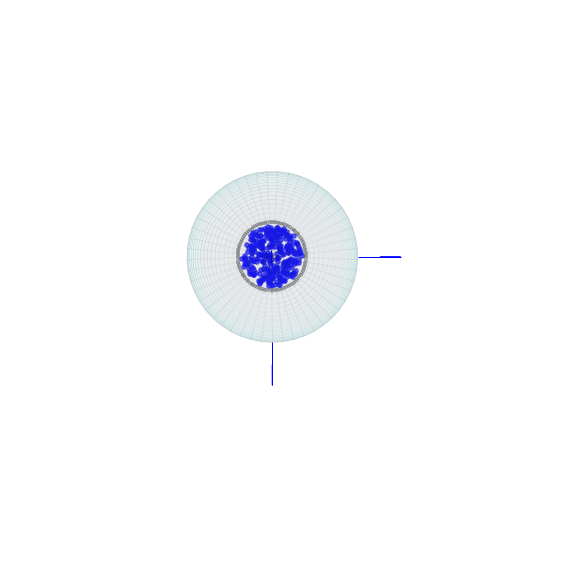

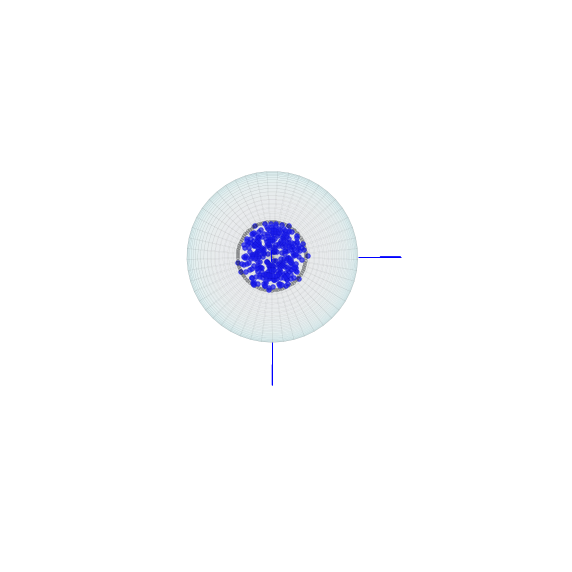

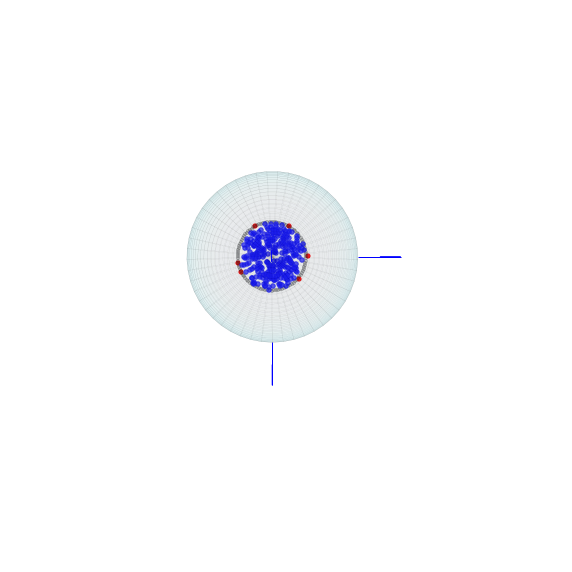

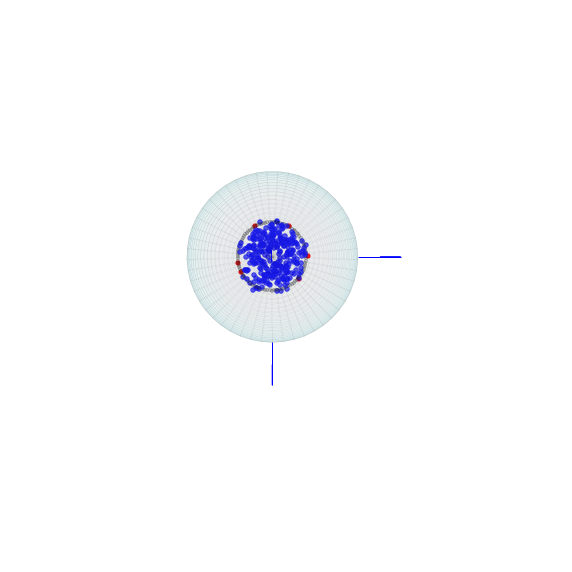

...

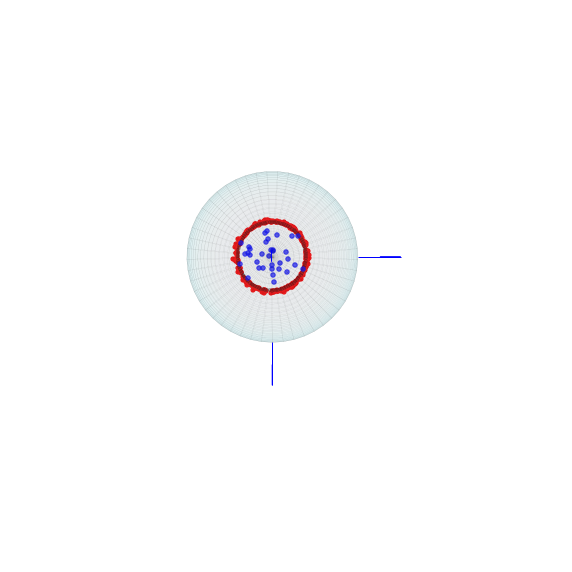

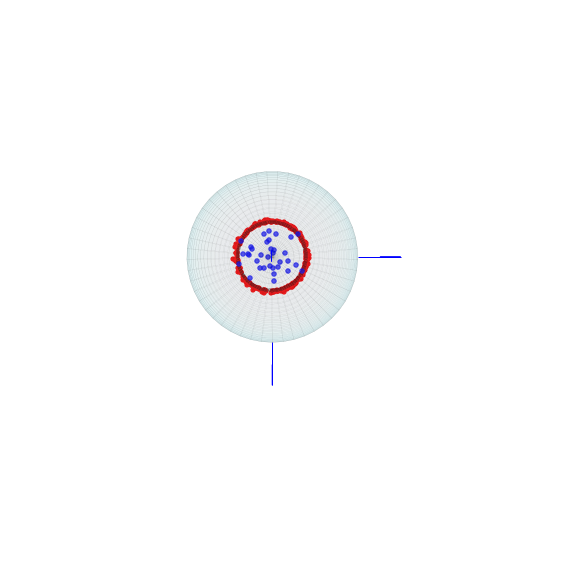

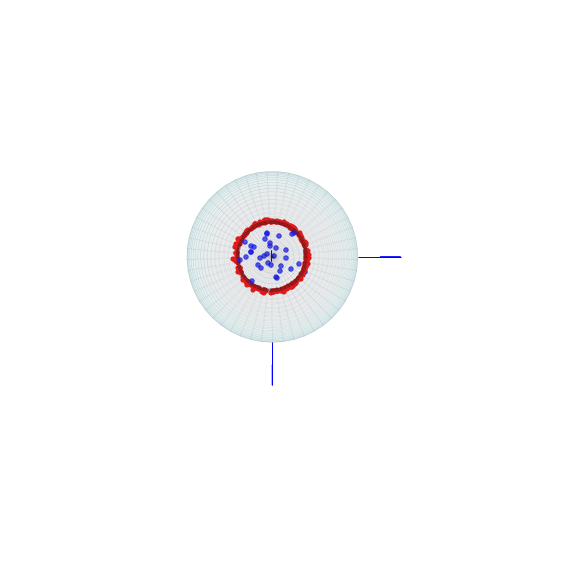

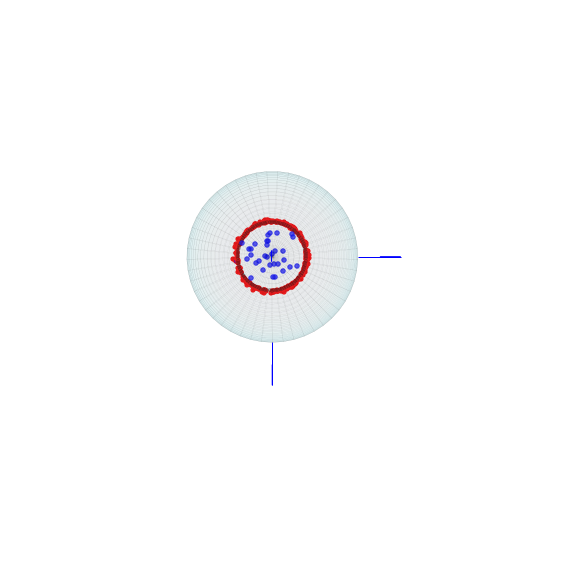

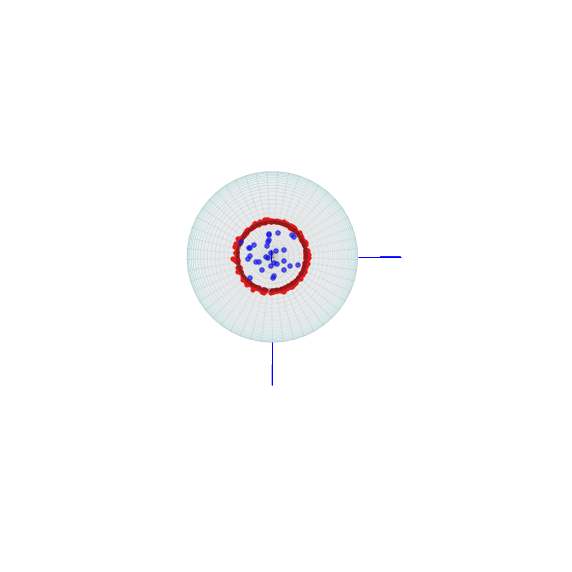

KeyboardInterrupt: 

AttributeError: 'PathCollection' object has no attribute 'do_3d_projection'

In [60]:
#Simulacion del Primer tiempo de salida para una region de tamaño.
pos_ini = uniform_inside_omega(10000,1, theta1-0.05)
tiempo = 0
tiempos_salida = []
tamanho = np.cos(theta1)
r_omega = np.array([0,0,1])
#plot_particles(pos_ini,90,0,1)
frozen = []
#plot_particle_Region_frozen(estructura_obs, pos_ini, frozen, 90, 0, 1)
for i in range(10000):
    tiempo = tiempo + dt
    nuevas_pos = act_n(pos_ini, ese(D,dt))
    #plot_particles(nuevas_pos, 90,0,1)
    #plot_particle_Region_frozen(estructura_obs, nuevas_pos, frozen, 90, 0, 1)
    survey = []
    for v in nuevas_pos:
        if np.dot(r_omega, v) <= tamanho:
            tiempos_salida.append(tiempo)
            frozen.append(v)
        else:
            survey.append(v)
    if len(survey) == 0:
        break
    else:
        pos_ini = survey

In [61]:
len(tiempos_salida)

268

In [50]:
sample1 = tiempos_salida

(array([  65.,  119.,  117.,   64.,   51.,   61.,   91.,   41.,   43.,
          27.,   28.,   15.,   31.,   19.,   11.,   28.,   21.,    8.,
          20.,   10.,    4.,    3.,   11.,    7.,    8.,    5.,    7.,
           6.,    5.,    2.,    4.,    4.,    4.,    2.,    3.,    5.,
           4.,    3.,    4.,    0.,    2.,    4.,    1.,    0.,    3.,
           1.,    6.,    0.,    3.,    0.,    2.,    0.,    1.,    3.,
           0.,    1.,    1.,    0.,    1.,    0.,    0.,    0.,    0.,
           1.,    0.,    1.,    1.,    1.,    2.,    1.,    0.,    0.,
           0.,    0.,    0.,    1.,    0.,    0.,    0.,    2.]),
 array([ 0.00115129,  0.00349993,  0.00584857,  0.0081972 ,  0.01054584,
         0.01289448,  0.01524311,  0.01759175,  0.01994039,  0.02228902,
         0.02463766,  0.0269863 ,  0.02933493,  0.03168357,  0.03403221,
         0.03638084,  0.03872948,  0.04107812,  0.04342675,  0.04577539,
         0.04812403,  0.05047267,  0.0528213 ,  0.05516994,  0.05751858,
 

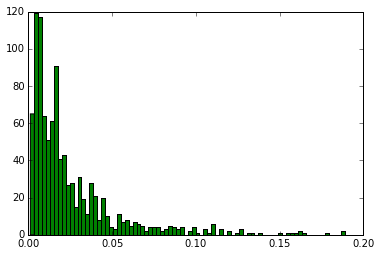

In [52]:
plt.hist(sample1,80,color = 'g')

In [53]:
np.mean(sample1)

0.025177616699343416

In [54]:
np.var(sample1)

0.00079619727794905755

In [55]:
np.sqrt(2)

1.4142135623730951

In [8]:

def plot_particle_Region_frozen(lista_region, trayectoria, lista_frozen, vpolar, vazim, numero):
    from mpl_toolkits.mplot3d import axes3d
    from mpl_toolkits.mplot3d import Axes3D
    from matplotlib import cm

    #import matplotlib.pyplot as plt
    #import numpy as np
    from itertools import product, combinations
    fig = plt.figure(figsize=(20,10))
    ax = fig.gca(projection='3d')
    ax.set_aspect("equal")
    ax._axis3don = False
    

    



    #draw sphere
    R = 1
    u, v = np.mgrid[0:2*np.pi:50j, 0:np.pi:50j]
    x=R*np.cos(u)*np.sin(v)
    y=R*np.sin(u)*np.sin(v)
    z=R*np.cos(v)
    #ax.plot_surface(x, y, z, color="r", alpha = 0.15)

    ax.plot_surface(x, y, z, cmap=cm.YlGnBu_r,rstride=1, cstride=1, alpha = 0.10, linewidth = 0.15)
    ax.view_init(vpolar, vazim)
    #draw patch
    #u, v = np.mgrid[0:2*np.pi:50j, 0:(np.pi/7):50j]
    #x=R*np.cos(u)*np.sin(v)
    #y=R*np.sin(u)*np.sin(v)
    #z=R*np.cos(v)
    #ax.plot_surface(x, y, z, color="r", alpha = 0.25)
    
    
    
    #draw Region
    
    for p in lista_region:
        ax.scatter([p[0]],[p[1]],[p[2]], color="k", s=10, alpha = 0.2)
        
        
    #draw the frozen ones on the boundary
    
    for p in lista_frozen:
        ax.scatter([p[0]],[p[1]],[p[2]], color="r", s=17, alpha = 1.0)
    
    #draw trajectory
    for p in trayectoria:
        ax.scatter([p[0]],[p[1]],[p[2]], color="b",s=20, alpha = 0.7)
    
    #Plot the x positive direction
    
    ax.quiver(1.5,0,0,1,0,0, length=0.5, arrow_length_ratio = .5)
    ax.quiver(0,1.5,0,0,1,0, length=0.5, arrow_length_ratio = .5)
    ax.quiver(0,0,1.5,0,0,1, length=0.5, arrow_length_ratio = .5)
    
    #fig.savefig('BS_24_Obs_test_01{}.png'.format(nombre(numero + 1)))
    #ax.view_init(80, 30)
    #plt.close()
    plt.show()

In [47]:
estructura_obs = puntos_obs([r_omega], theta1)

/Users/adriano/anaconda/lib/python2.7/site-packages/IPython/kernel/__main__.py:163: RuntimeWarning: divide by zero encountered in long_scalars


## Divide by Zero!!!

### Probably this might have something  to do with the overall screw up...

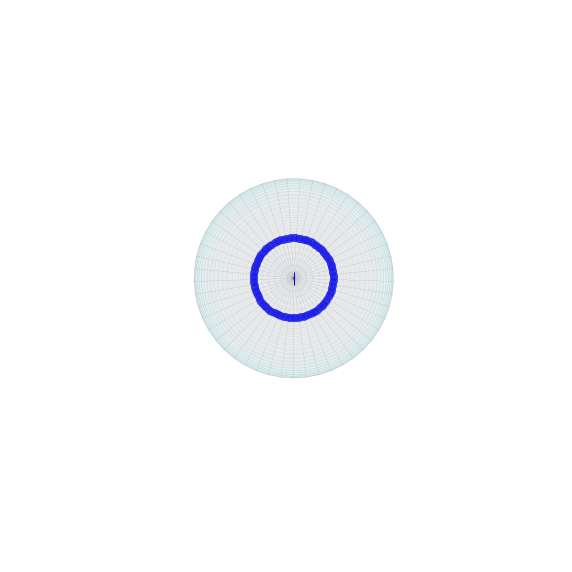

In [48]:
plot_particles(estructura_obs, 90,0,0)

In [19]:
suma = 0
for i in range(100):
    suma = suma + .01

In [20]:
suma

1.0000000000000007

In [13]:
#Simulacion del Primer tiempo de salida para una region de tamaño.
pos_ini = uniform_inside_omega(10000,1, theta1-0.05)
tiempo = 0
tiempos_salida = []
tamanho = np.cos(theta1)
r_omega = np.array([0,0,1])
#plot_particles(pos_ini,90,0,1)
frozen = []
#plot_particle_Region_frozen(estructura_obs, pos_ini, frozen, 90, 0, 1)
for i in range(10000):
    tiempo = tiempo + dt
    nuevas_pos = act_n(pos_ini, ese(D,dt))
    #plot_particles(nuevas_pos, 90,0,1)
    #plot_particle_Region_frozen(estructura_obs, nuevas_pos, frozen, 90, 0, 1)
    survey = []
    for v in nuevas_pos:
        if np.dot(r_omega, v) <= tamanho:
            tiempos_salida.append(tiempo)
            frozen.append(v)
        else:
            survey.append(v)
    if len(survey) == 0:
        break
    else:
        pos_ini = survey

In [15]:
len(tiempos_salida)

10000

(array([  1.99500000e+03,   1.25000000e+03,   5.98000000e+02,
          4.82000000e+02,   7.50000000e+02,   5.88000000e+02,
          4.18000000e+02,   3.58000000e+02,   3.34000000e+02,
          5.35000000e+02,   3.72000000e+02,   2.98000000e+02,
          3.01000000e+02,   1.35000000e+02,   2.63000000e+02,
          1.26000000e+02,   1.11000000e+02,   1.63000000e+02,
          4.70000000e+01,   8.40000000e+01,   5.40000000e+01,
          1.28000000e+02,   4.10000000e+01,   6.20000000e+01,
          4.50000000e+01,   5.00000000e+01,   1.80000000e+01,
          4.30000000e+01,   3.70000000e+01,   1.60000000e+01,
          2.20000000e+01,   1.80000000e+01,   1.90000000e+01,
          2.80000000e+01,   2.90000000e+01,   3.60000000e+01,
          7.00000000e+00,   6.00000000e+00,   1.00000000e+01,
          1.40000000e+01,   1.20000000e+01,   1.00000000e+01,
          5.00000000e+00,   1.20000000e+01,   7.00000000e+00,
          7.00000000e+00,   3.00000000e+00,   7.00000000e+00,
        

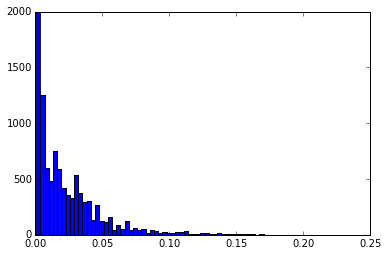

In [18]:
plt.hist(tiempos_salida, 70)

In [19]:
#Simulacion del Primer tiempo de salida para una region de tamaño.
pos_ini = uniform_inside_omega(100000,1, theta1-0.05)
tiempo = 0
tiempos_salida = []
tamanho = np.cos(theta1)
r_omega = np.array([0,0,1])
#plot_particles(pos_ini,90,0,1)
frozen = []
#plot_particle_Region_frozen(estructura_obs, pos_ini, frozen, 90, 0, 1)
for i in range(10000):
    tiempo = tiempo + dt
    nuevas_pos = act_n(pos_ini, ese(D,dt))
    #plot_particles(nuevas_pos, 90,0,1)
    #plot_particle_Region_frozen(estructura_obs, nuevas_pos, frozen, 90, 0, 1)
    survey = []
    for v in nuevas_pos:
        if np.dot(r_omega, v) <= tamanho:
            tiempos_salida.append(tiempo)
            frozen.append(v)
        else:
            survey.append(v)
    if len(survey) == 0:
        break
    else:
        pos_ini = survey

In [20]:
sample2 = tiempos_salida

(array([  2.10260000e+04,   1.25300000e+04,   1.49480000e+04,
          6.60600000e+03,   8.27200000e+03,   7.12700000e+03,
          2.87300000e+03,   3.86600000e+03,   3.20100000e+03,
          4.77800000e+03,   1.61000000e+03,   1.91400000e+03,
          1.19000000e+03,   2.57100000e+03,   8.13000000e+02,
          8.66000000e+02,   1.37000000e+03,   8.85000000e+02,
          4.45000000e+02,   4.54000000e+02,   2.44000000e+02,
          4.32000000e+02,   2.99000000e+02,   4.05000000e+02,
          2.04000000e+02,   1.87000000e+02,   6.90000000e+01,
          1.33000000e+02,   1.13000000e+02,   4.90000000e+01,
          6.30000000e+01,   8.30000000e+01,   6.60000000e+01,
          6.20000000e+01,   3.80000000e+01,   2.00000000e+01,
          2.50000000e+01,   1.20000000e+01,   3.60000000e+01,
          2.60000000e+01,   1.20000000e+01,   1.50000000e+01,
          1.00000000e+01,   6.00000000e+00,   1.00000000e+01,
          3.00000000e+00,   7.00000000e+00,   1.00000000e+00,
        

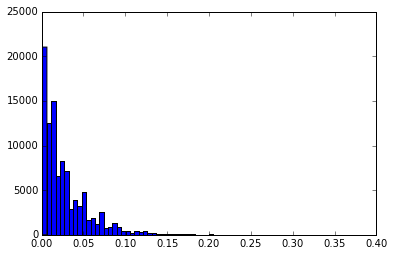

In [27]:
plt.hist(sample2,75)

In [22]:
len(sample2)

100000

In [23]:
np.mean(sample2)

0.028518094325589636

In [24]:
np.var(sample2)

0.00087143036392317585

In [28]:
#Simulacion del Primer tiempo de salida para una region de tamaño.
pos_ini = uniform_inside_omega(1000000,1, theta1-0.05)
tiempo = 0
tiempos_salida_A = []
tamanho = np.cos(theta1)
r_omega = np.array([0,0,1])
#plot_particles(pos_ini,90,0,1)
frozen = []
#plot_particle_Region_frozen(estructura_obs, pos_ini, frozen, 90, 0, 1)
for i in range(10000):
    tiempo = tiempo + dt
    nuevas_pos = act_n(pos_ini, ese(D,dt))
    #plot_particles(nuevas_pos, 90,0,1)
    #plot_particle_Region_frozen(estructura_obs, nuevas_pos, frozen, 90, 0, 1)
    survey = []
    for v in nuevas_pos:
        if np.dot(r_omega, v) <= tamanho:
            tiempos_salida_A.append(tiempo)
            frozen.append(v)
        else:
            survey.append(v)
    if len(survey) == 0:
        break
    else:
        pos_ini = survey

In [29]:
sample3 = tiempos_salida_A

(array([  4.79605052e+01,   1.89469822e+01,   1.28710263e+01,
          1.60347659e+01,   1.30395166e+01,   6.56324458e+00,
          6.14580671e+00,   7.30448090e+00,   4.61075659e+00,
          2.91873165e+00,   3.85436826e+00,   2.12188746e+00,
          1.68596413e+00,   1.26988994e+00,   1.46322959e+00,
          1.01533618e+00,   5.14865294e-01,   7.06386699e-01,
          4.28498838e-01,   3.87739932e-01,   3.76375924e-01,
          1.71823792e-01,   1.92430525e-01,   1.94703326e-01,
          1.45307774e-01,   9.56091821e-02,   1.02730627e-01,
          1.01518466e-01,   4.06073864e-02,   5.27289942e-02,
          2.56068966e-02,   2.69705775e-02,   1.86369721e-02,
          2.43947358e-02,   2.45462559e-02,   1.92430525e-02,
          1.37883290e-02,   8.63664561e-03,   9.39424610e-03,
          5.45472354e-03,   8.63664561e-03,   2.72736177e-03,
          3.03040197e-03,   3.48496226e-03,   1.36368089e-03,
          1.21216079e-03,   7.57600492e-04,   1.21216079e-03,
        

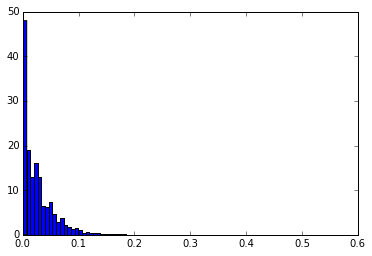

In [44]:
plt.hist(sample3,80, normed = True)
#plt.xlim(0,.3)

In [31]:
np.mean(sample3)

0.027192567467690849

In [32]:
np.var(sample3)

0.00086924570460325198

In [42]:
plt.hist2d?

In [45]:
#Simulacion del Primer tiempo de salida para una region de tamaño.

D = 1e-2
dt = (2.3**2/4.)*1e-5
theta1 = 2.3*1e-2
theta2 = 0.1


pos_ini = uniform_inside_omega(10000,1, theta1-0.005)
tiempo = 0
tiempos_salida_A = []
tamanho = np.cos(theta1)
r_omega = np.array([0,0,1])
#plot_particles(pos_ini,90,0,1)
frozen = []
#plot_particle_Region_frozen(estructura_obs, pos_ini, frozen, 90, 0, 1)
for i in range(10000):
    tiempo = tiempo + dt
    nuevas_pos = act_n(pos_ini, ese(D,dt))
    #plot_particles(nuevas_pos, 90,0,1)
    #plot_particle_Region_frozen(estructura_obs, nuevas_pos, frozen, 90, 0, 1)
    survey = []
    for v in nuevas_pos:
        if np.dot(r_omega, v) <= tamanho:
            tiempos_salida_A.append(tiempo)
            frozen.append(v)
        else:
            survey.append(v)
    if len(survey) == 0:
        break
    else:
        pos_ini = survey

In [46]:
sample4 = tiempos_salida_A

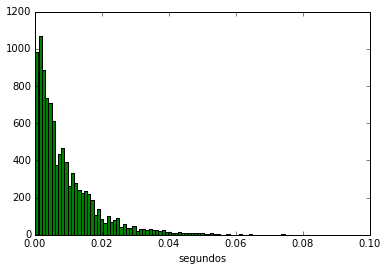

In [47]:
plt.hist(sample4, 100, color = 'g')
plt.xlabel('segundos')

In [48]:
np.mean(sample4)

0.0091556357599999489

In [52]:
R = 1.
D = 1.
dt = 1e-3

In [53]:
R = 1
D = 1
#dt = 1e-3*np.log(10)
origen = polo_n(10000,R)
promedio_theta_en_t = [0]
promedio_phi_en_t = [0]
promedio_cos_theta = [np.cos(0)]
var_theta_en_t = [0]
var_phi_en_t = [0]
posicion_vec = origen
t_final = 2500

for i in range(t_final):
    nuevos_vec = act_n(posicion_vec, ese(D,dt))
    thetas = []

    phis = []

    for v in nuevos_vec:
        theta = np.arccos(v[2]/R)
        phi = np.arctan(v[1]/v[0])
        thetas.append(theta)

        phis.append(phi)

    
    #Aqui vamos a salvar una instantanea de cada uno de los histogramas
    #de theta
    #plt.hist(thetas, 50, color = 'g', alpha = 0.6, normed = "true")
    #plt.xlabel(r"$\theta$", fontsize = 15)
    #plt.xlim(0,np.pi)
    #plt.ylabel(r"$n(\theta)/10000$", fontsize = 15)
    #plt.ylim(0,1)
    #plt.title("Paso = {}".format(i), fontsize = 15)
    #plt.savefig('Histograma_theta_{}'.format(nombre(i)), dpi = 600, bbox_inches = 'tight')
    #plt.close()
    mean_cos_theta = np.mean(np.cos(thetas))
    mean_theta = np.mean(thetas)
    mean_phi = np.mean(phis)

    var_theta_en_t.append(np.var(thetas))
    var_phi_en_t.append(np.var(phis))
    promedio_theta_en_t.append(mean_theta)
    promedio_phi_en_t.append(mean_phi)
    posicion_vec = nuevos_vec
    promedio_cos_theta.append(mean_cos_theta)

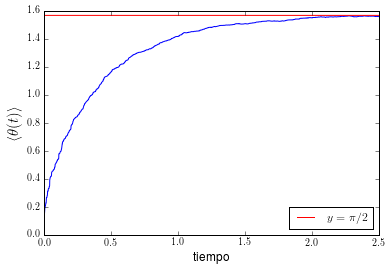

In [54]:
npasos = t_final
suma = 0
tiempos = [0]
impulso = dt
for i in range(npasos):
    suma += impulso
    tiempos.append(suma)
    
    
plt.rc('text', usetex=True)
plt.plot(tiempos,promedio_theta_en_t)
plt.plot(tiempos, np.pi/2*np.ones(len(tiempos)), 'r', label ="$y = \pi/2$")
plt.ylabel(r'$\langle \theta(t)\rangle$', fontsize = 15)
plt.xlabel('tiempo', fontsize = 12)
plt.legend(loc=4); # Down right corner

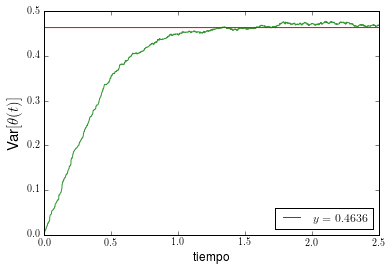

In [55]:
plt.rc('text', usetex=True)
plt.plot(tiempos,var_theta_en_t, alpha = .8, color = 'g')
plt.plot(tiempos, 0.46358922651739204*np.ones(len(tiempos)), 'r', label ="$y = 0.4636$")
plt.ylabel(r'$\mbox{Var}[\theta(t)]$', fontsize = 15)
plt.xlabel('tiempo', fontsize = 12)
plt.legend(loc=4); # down right corner

In [58]:
npasos = 2500
suma = 0
tiempos = [0]
impulso = dt
for i in range(npasos):
    suma += impulso
    tiempos.append(suma)

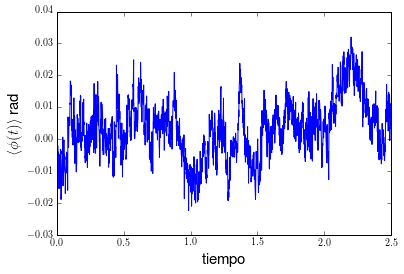

In [59]:
plt.rc('text', usetex=True)  
plt.plot(tiempos, promedio_phi_en_t)
plt.ylabel(r'$\langle \phi(t)\rangle$ $\mbox{rad}$', fontsize = 15)
plt.xlabel('tiempo', fontsize = 15)

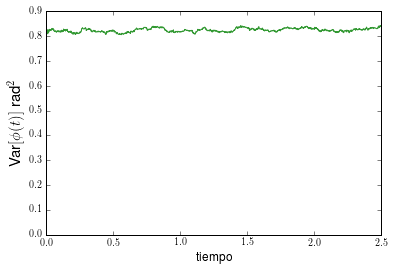

In [60]:
plt.rc('text', usetex=True)
plt.plot(tiempos, var_phi_en_t, alpha = .8, color = 'g')
plt.ylabel(r'$\mbox{Var}[\phi(t)]$ $\mbox{rad}^2$', fontsize = 15)
plt.xlabel('tiempo', fontsize = 12)

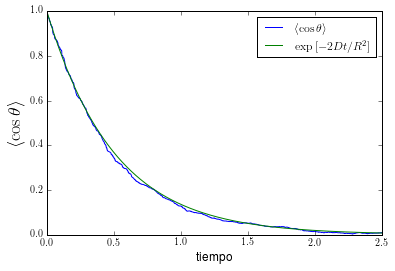

In [61]:
plt.plot(tiempos[:], promedio_cos_theta[:], label=r"$\langle \cos{\theta} \rangle$")
#plt.yscale("log")
#plt.plot(tiempos, np.exp(-4*tiempos))
plt.plot(np.array(tiempos[:]), np.exp(-2*np.array(tiempos[:])), label=r"$\exp{[-2Dt/R^2]}$")
plt.ylabel(r'$\langle \cos{\theta} \rangle$', fontsize = 18)
plt.xlabel('tiempo', fontsize = 12)
plt.legend(loc=0); # upper right

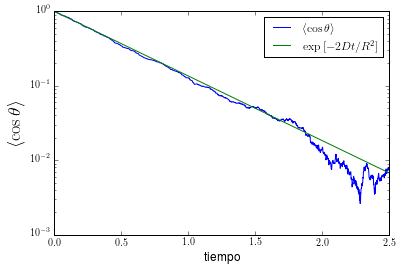

In [62]:
plt.plot(tiempos[:], promedio_cos_theta[:], label=r"$\langle \cos{\theta} \rangle$")
#plt.yscale("log")
#plt.plot(tiempos, np.exp(-4*tiempos))
plt.plot(np.array(tiempos[:]), np.exp(-2*np.array(tiempos[:])), label=r"$\exp{[-2Dt/R^2]}$")
plt.ylabel(r'$\langle \cos{\theta} \rangle$', fontsize = 18)
plt.yscale("log")
plt.xlabel('tiempo', fontsize = 12)
plt.legend(loc=0); # upper right

In [63]:
A = np.vstack((tiempos, np.ones(len(tiempos)))).T
m, c = np.linalg.lstsq(A, np.log(np.array(promedio_cos_theta)))[0]
print m, c

-2.16549608729 0.0797059581453


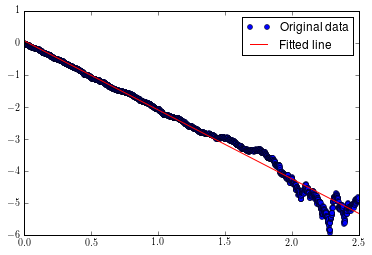

In [64]:
plt.plot(tiempos, np.log(np.array(promedio_cos_theta)), 'o', label='Original data', markersize=5)
plt.plot(tiempos, m*np.array(tiempos) + c, 'r', label='Fitted line')
plt.legend()
plt.show()

In [65]:
R = 1
D = 1
t_final = 2000
n = 10000
#dt = 1e-3*np.log(10)
dt = 1e-3

In [9]:
def sim_NO_(R,D,dt, t_final, n):


    origen = polo_n(n,R)
    promedio_theta_en_t = [0]
    promedio_phi_en_t = [0]
    promedio_cos_theta = [np.cos(0)]
    var_theta_en_t = [0]
    var_phi_en_t = [0]
    posicion_vec = origen


    for i in range(t_final):
        nuevos_vec = act_n(posicion_vec, ese(D,dt))
        thetas = []

        phis = []

        for v in nuevos_vec:
            theta = np.arccos(v[2]/R)
            phi = np.arctan(v[1]/v[0])
            thetas.append(theta)

            phis.append(phi)


        #Aqui vamos a salvar una instantanea de cada uno de los histogramas
        #de theta
        #plt.hist(thetas, 50, color = 'g', alpha = 0.6, normed = "true")
        #plt.xlabel(r"$\theta$", fontsize = 15)
        #plt.xlim(0,np.pi)
        #plt.ylabel(r"$n(\theta)/10000$", fontsize = 15)
        #plt.ylim(0,1)
        #plt.title("Paso = {}".format(i), fontsize = 15)
        #plt.savefig('Histograma_theta_{}'.format(nombre(i)), dpi = 600, bbox_inches = 'tight')
        #plt.close()
        mean_cos_theta = np.mean(np.cos(thetas))
        mean_theta = np.mean(thetas)
        mean_phi = np.mean(phis)

        var_theta_en_t.append(np.var(thetas))
        var_phi_en_t.append(np.var(phis))
        promedio_theta_en_t.append(mean_theta)
        promedio_phi_en_t.append(mean_phi)
        posicion_vec = nuevos_vec
        promedio_cos_theta.append(mean_cos_theta)
        
    return promedio_theta_en_t, promedio_phi_en_t, promedio_cos_theta, var_theta_en_t, var_phi_en_t

In [68]:
a, b, c, d, e = sim_NO_(1,2,1e-5, 2000, 1000)

(array([  1.,   0.,   1.,   4.,   0.,   2.,   1.,   5.,   1.,   3.,   9.,
         10.,   6.,  10.,   5.,  17.,   7.,   5.,  21.,  12.,   2.,  13.,
          8.,  14.,  19.,  14.,   0.,  15.,   7.,  10.,  14.,   8.,   2.,
         13.,  15.,  15.,  14.,  14.,  13.,   9.,  12.,  17.,  19.,  13.,
         16.,  17.,  12.,  13.,  24.,  21.,  29.,  20.,  35.,  29.,  10.,
         28.,   8.,  36.,  15.,  18.,  36.,  15.,  22.,  25.,  22.,  35.,
         46.,  53.,  13.,  14.,  24.,  12.,  41.,  25.,  23.,  16.,  40.,
         17.,   8.,  23.,  11.,  57.,  35.,  38.,  56.,  33.,  39.,  27.,
         18.,  23.,  38.,  59.,  37.,  34.,  47.,  63.,  17.,  39.,  47.,
         42.]),
 array([ 0.        ,  0.00355142,  0.00710283,  0.01065425,  0.01420566,
         0.01775708,  0.0213085 ,  0.02485991,  0.02841133,  0.03196274,
         0.03551416,  0.03906558,  0.04261699,  0.04616841,  0.04971982,
         0.05327124,  0.05682266,  0.06037407,  0.06392549,  0.0674769 ,
         0.07102832,  0.07

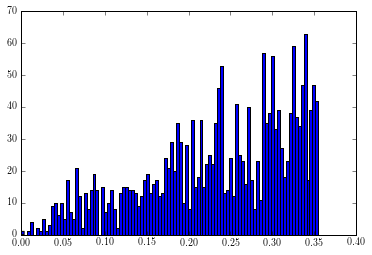

In [69]:
plt.hist(a,100)

In [106]:
ensambles_theta_t = []
ensambles_phi_t = []
ensambles_cos_theta_t = []
ensambles_var_theta_t = []
ensambles_var_phi_t = []
for i in range(1,11):
    a, b, c, d, e = sim_NO_(1 , i, np.log(10)*1e-4, 2500, 4000)
    ensambles_theta_t.append(a)
    ensambles_phi_t.append(b)
    ensambles_cos_theta_t.append(c)
    ensambles_var_theta_t.append(d)
    ensambles_var_phi_t.append(e)

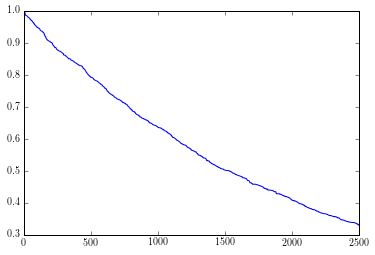

In [107]:
plt.plot(ensambles_cos_theta_t[0])

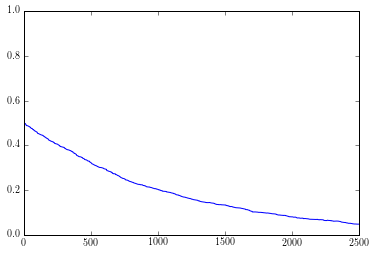

In [90]:
plt.plot(ensambles_cos_theta_t[1])

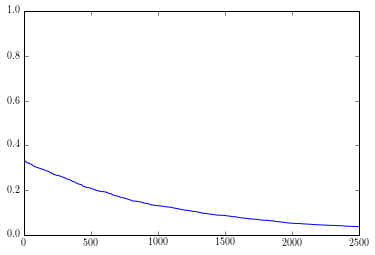

In [91]:
plt.plot(ensambles_cos_theta_t[2])

In [92]:
npasos = 2500

In [11]:
def f_tiempo(npasos, dt):

    suma = 0
    tiempos = [0]
    impulso = dt
    for i in range(npasos):
        suma += impulso
        tiempos.append(suma)
    return tiempos

In [102]:
t1 = f_tiempo(npasos, dt)

In [86]:
len(ensambles_cos_theta_t[3])

2001

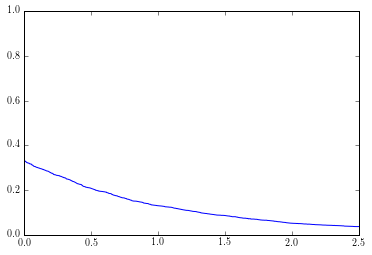

In [98]:
plt.plot(t1, ensambles_cos_theta_t[2])

In [114]:
for i in range(1,10):
    A = np.vstack((t1, np.ones(len(t1[:])))).T
    m, c = np.linalg.lstsq(A, np.log(np.array(ensambles_cos_theta_t[i][:])))[0]
    print i, m, c

1 -0.983329036129 0.0334720035686
2 -1.38712022029 -0.0521067993034
3 -2.00149283495 0.0690505740265
4 nan nan
5 nan nan
6 nan nan
7 nan nan
8 nan nan
9 nan nan


/Users/draflorencia/anaconda/lib/python2.7/site-packages/IPython/kernel/__main__.py:3: RuntimeWarning: invalid value encountered in log
  app.launch_new_instance()


In [ ]:
plt.plot(tiempo,)

In [115]:
ensambles_02_theta_t = []
ensambles_02_phi_t = []
ensambles_02_cos_theta_t = []
ensambles_02_var_theta_t = []
ensambles_02_var_phi_t = []
for i in range(1,11):
    a, b, c, d, e = sim_NO_(1 , i, np.log(10)*1e-3, 2500, 1000)
    ensambles_02_theta_t.append(a)
    ensambles_02_phi_t.append(b)
    ensambles_02_cos_theta_t.append(c)
    ensambles_02_var_theta_t.append(d)
    ensambles_02_var_phi_t.append(e)

In [116]:
t2 = f_tiempo(2500, np.log(10)*1e-3)

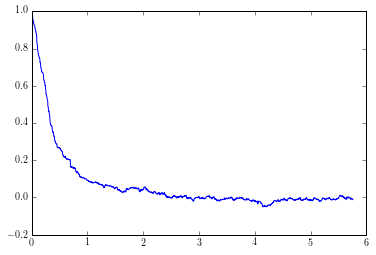

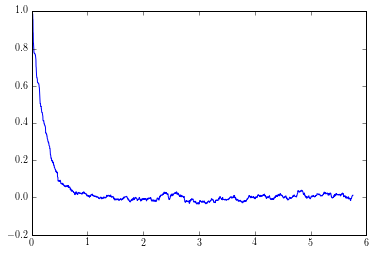

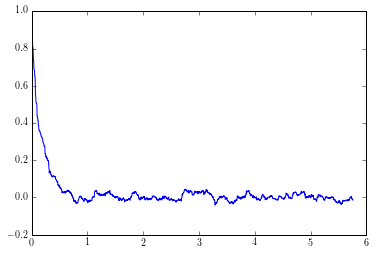

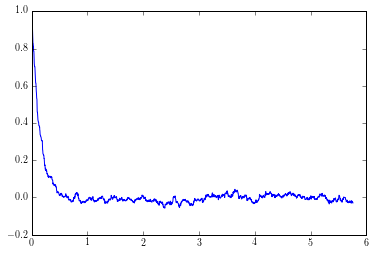

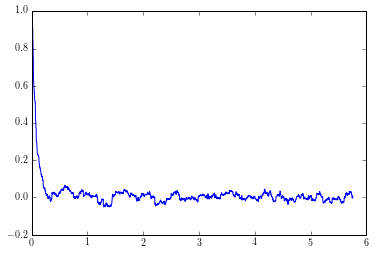

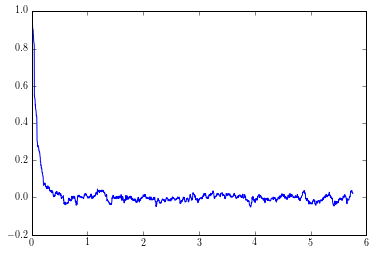

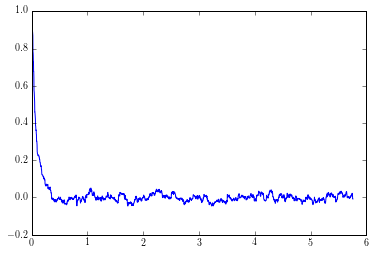

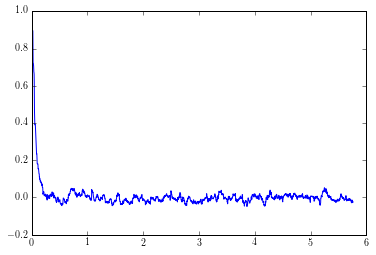

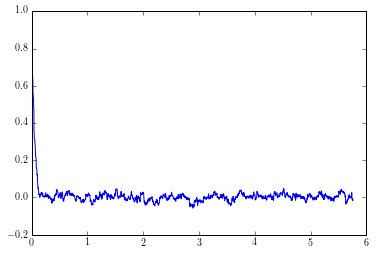

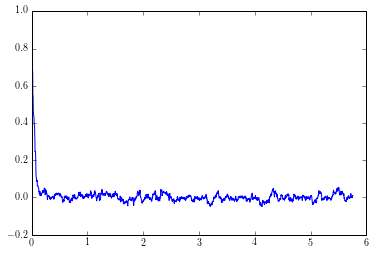

In [118]:
for i in range(10):
    fig = plt.figure()
    plt.plot(t2, ensambles_02_cos_theta_t[i])

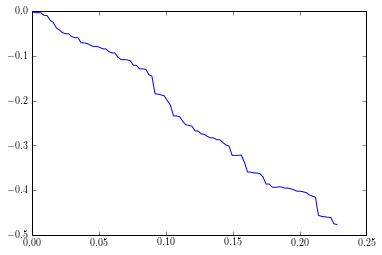

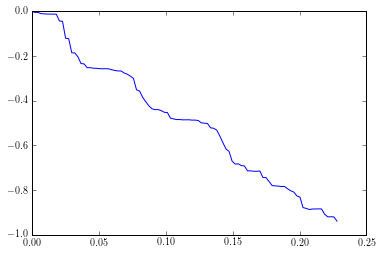

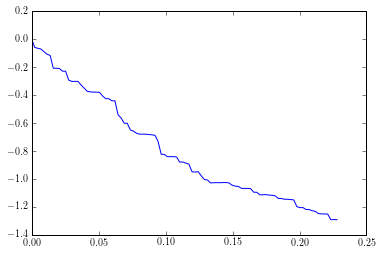

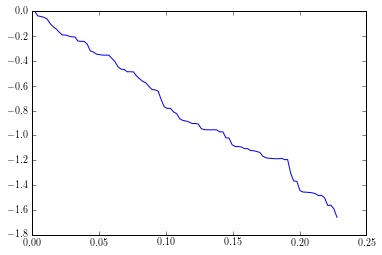

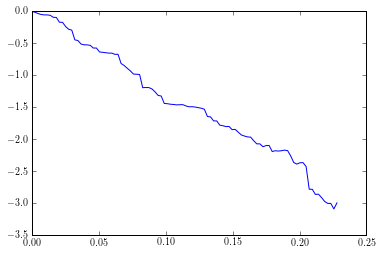

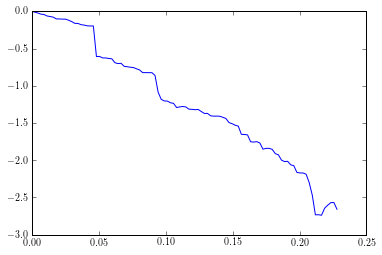

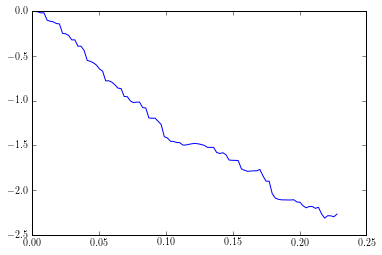

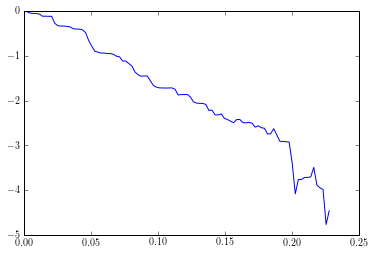

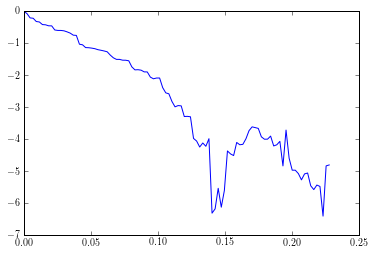

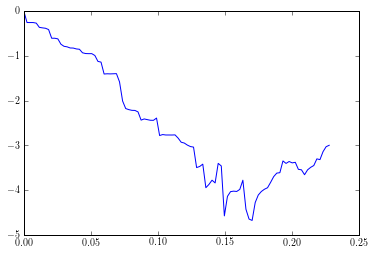

In [121]:
for i in range(10):
    fig = plt.figure()
    plt.plot(t2[:100], np.log(ensambles_02_cos_theta_t[i][:100]))

In [125]:
for i in range(10):
    a = ensambles_02_cos_theta_t[i][80] - ensambles_02_cos_theta_t[i][0]
    b = t2[80] - t2[0]
    m = a/b
    print 'm', m

m -1.76500064285
m -2.94758369122
m -3.69476378019
m -3.77481773991
m -4.82136508196
m -4.63872627917
m -4.76724757456
m -5.07843905518
m -5.31999372276
m -5.31078959868


In [128]:
t3 = f_tiempo(2000,np.log(10)*1e-3)

In [127]:
ensambles_03_theta_t = []
ensambles_03_phi_t = []
ensambles_03_cos_theta_t = []
ensambles_03_var_theta_t = []
ensambles_03_var_phi_t = []
for i in range(1,11):
    a, b, c, d, e = sim_NO_(1 , (i), np.log(10)*1e-3, 2000, 4000)
    ensambles_03_theta_t.append(a)
    ensambles_03_phi_t.append(b)
    ensambles_03_cos_theta_t.append(c)
    ensambles_03_var_theta_t.append(d)
    ensambles_03_var_phi_t.append(e)

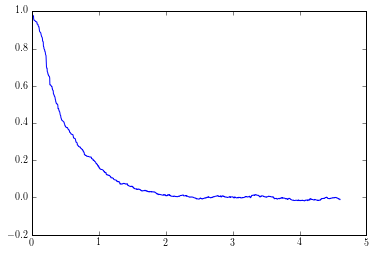

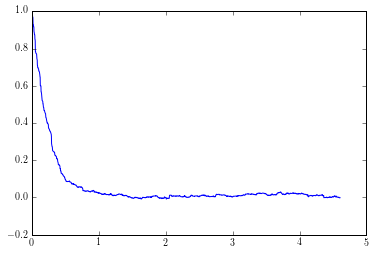

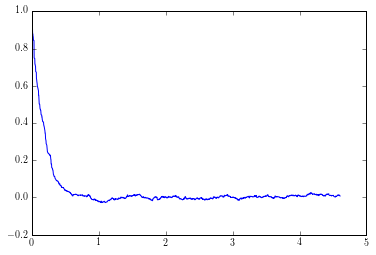

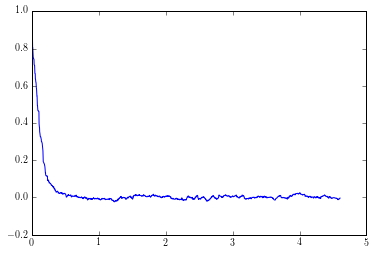

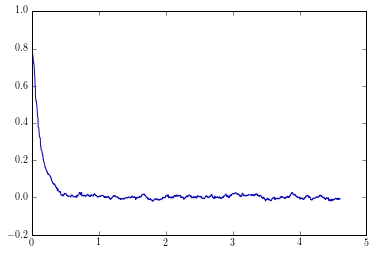

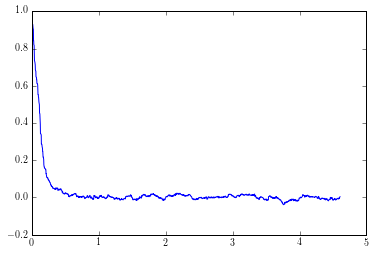

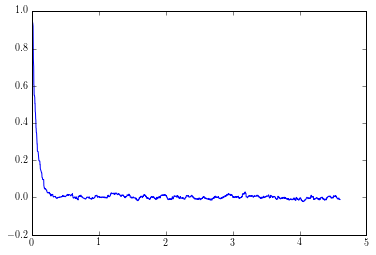

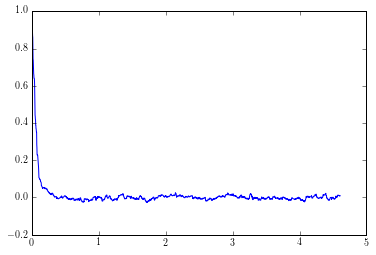

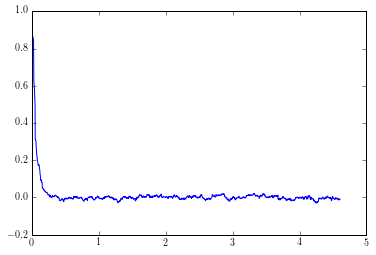

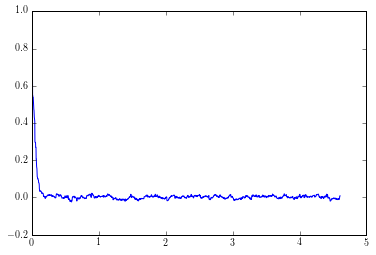

In [129]:
for i in range(10):
    fig = plt.figure()
    plt.plot(t3, ensambles_03_cos_theta_t[i])

In [151]:
A = np.vstack((t3[:100], np.ones(len(t3[:100])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(ensambles_03_cos_theta_t[3][:100])))[0]
print m, c

-9.45871299106 0.0718818933935


In [152]:
ax, bx, cx, dx, ex = sim_NO_(1 , 5, np.log(10)*1e-6, 1000, 100000)

In [153]:
tx = f_tiempo(1000,np.log(10)*1e-6)

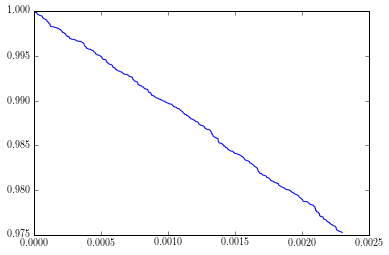

In [156]:
plt.plot(tx,cx)

In [157]:
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx[:])))[0]
print m, c

-10.7844629345 0.000230725127598


m -10.4507936667 c -0.000267604467391


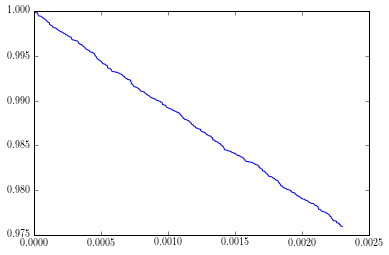

In [158]:
ax2, bx2, cx2, dx2, ex2 = sim_NO_(1 , 5, np.log(10)*1e-6, 1000, 400000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx2)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx2[:])))[0]
print 'm', m, 'c', c

m -1.9106618026 c -3.48087501022e-05


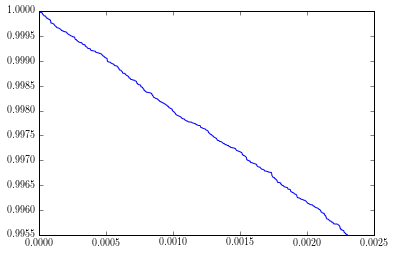

In [160]:
ax3, bx3, cx3, dx3, ex3 = sim_NO_(1 , 1, np.log(10)*1e-6, 1000, 10000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx3)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx3[:])))[0]
print 'm', m, 'c', c

m -4.20546183846 c -8.03872503989e-05


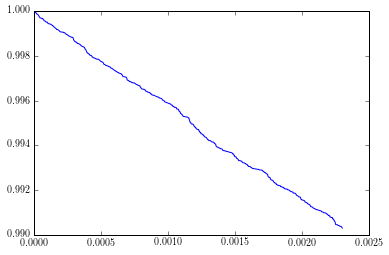

In [161]:
ax4, bx4, cx4, dx4, ex4 = sim_NO_(1 , 2., np.log(10)*1e-6, 1000, 10000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx4)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx4[:])))[0]
print 'm', m, 'c', c

m -4.29726372672 c 0.000140853368671


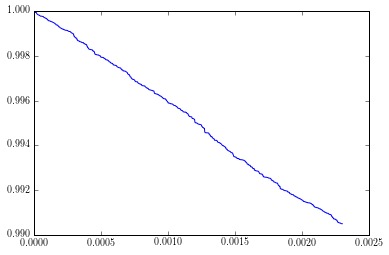

In [162]:
ax5, bx5, cx5, dx5, ex5 = sim_NO_(1 , 2., np.log(10)*1e-6, 1000, 10000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx5)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx5[:])))[0]
print 'm', m, 'c', c

m -5.91179220663 c 0.000140327779894


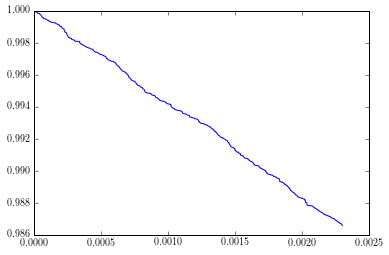

In [163]:
ax6, bx6, cx6, dx6, ex6 = sim_NO_(1 , 3., np.log(10)*1e-6, 1000, 10000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx6)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx6[:])))[0]
print 'm', m, 'c', c

m -7.46486409744 c 0.000197352889507


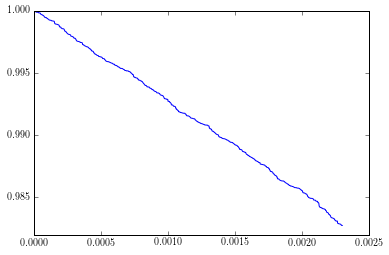

In [164]:
ax7, bx7, cx7, dx7, ex7 = sim_NO_(1 , 4., np.log(10)*1e-6, 1000, 10000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx7)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx7[:])))[0]
print 'm', m, 'c', c

m -9.87688769062 c 6.30797523952e-05


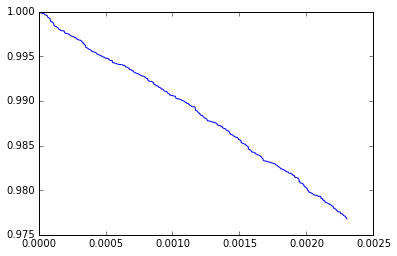

In [12]:
#ax8, bx8, cx8, dx8, ex8 = sim_NO_(1 , 5., np.log(10)*1e-6, 1000, 10000)
tx = f_tiempo(1000,np.log(10)*1e-6)
plt.plot(tx,cx8)
A = np.vstack((tx[:], np.ones(len(tx[:])))).T
m, c = np.linalg.lstsq(A, np.log(np.array(cx8[:])))[0]
print 'm', m, 'c', c